In [1]:
## Enable matplotlib inline

## Imports
import pandas as pd
pd.set_option('mode.chained_assignment',None)
pd.set_option('display.mpl_style', 'default') 
pd.set_option('display.width', 5000) 
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows', 200)

import numpy as np

import math, copy, time, random

In [2]:
## --------------------------------------------------
def haversine(lon1, lat1, lon2, lat2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    
    sklearn implementation
    2 arcsin(sqrt(sin^2(0.5*dx)cos(x1)cos(x2)sin^2(0.5*dy)))
    
    
    """
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(math.radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = math.sin(dlat/2)**2 + math.cos(lat1) * math.cos(lat2) * math.sin(dlon/2)**2
    c = 2 * math.asin(math.sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

In [3]:
## --------------------------------------------------
def trip_work(trip):
    """
    Calculates the work for a trip
    """
    
    work = 0.0
    total_weight = 10.0 + trip['Weight'].sum()
    lon = 0
    lat = 90
    
    for i, row in trip.iterrows():
        current_lon = row['Longitude']
        current_lat = row['Latitude']
        current_w   = row['Weight']
        
        distance = haversine(lon, lat, current_lon, current_lat)
        work += distance * total_weight
        
        total_weight -= current_w
        lon = current_lon
        lat = current_lat
        
    work += haversine(lon, lat, 0, 90) * 10.0
    
    return work

In [4]:
## --------------------------------------------------
def total_work(df):
    """
    Calculates the total work on all gifts
    """
    
    n = df['TripId'].max()
    x = 0
    for i in range(1, n+1):
        trip = df[df['TripId'] == i]
        x += trip_work(trip)
    return x, n

In [5]:
## --------------------------------------------------
def optimize_steal(gifts_df, neighbor=1):
    """
    Optimize trips by stealing from neighbors
    """
    
    cumulative_improvement = 0
    n = gifts_df['TripId'].max()

    for i in range(1,n+1):
        
        before = i-neighbor
        current = i
        after  = i+neighbor
        
        if i <= neighbor:
            before = n + 1 - neighbor
        if i == n:
            after = neighbor
        
        trip_before = gifts_df[gifts_df['TripId'] == before]
        trip        = gifts_df[gifts_df['TripId'] == current]
        trip_after  = gifts_df[gifts_df['TripId'] == after]
    
        n_trip = len(trip)
    
        trip['order'] = np.arange(1,n_trip+1)
        inserts = [j+0.5 for j in xrange(n_trip+1)]
    
        mass_budget = 990 - trip['Weight'].sum()
        print 'Trip', i, 'mass budget:', mass_budget
        if mass_budget < 1.0: continue
    
        work_trip_before = trip_work(trip_before)
        work_trip        = trip_work(trip)
        work_trip_after  = trip_work(trip_after)
    
        initial_work = work_trip_before + work_trip + work_trip_after
    
        best_work = work_trip_before + work_trip
    
        for index, row in trip_before.iterrows():
        
            gift = int(row['GiftId'])
            mass = row['Weight']
            if mass_budget - mass < 0: continue
            row_df = row.to_frame().transpose()
            test_trip_before = trip_before[trip_before['GiftId'] != gift]
            work_trip_before = trip_work(test_trip_before)
        
            for k in inserts:
                row_df['order'] = k
                test_trip = pd.concat([trip, row_df])
                test_trip = test_trip.sort_values(by='order')
                work = trip_work(test_trip) + work_trip_before
                if work < best_work:
                    best_work = work
                    trip = test_trip
                    trip_before = test_trip_before
                    mass_budget -= mass
                    break
                
        best_work = trip_work(trip_after) + trip_work(trip)
                
        for index, row in trip_after.iterrows():
        
            gift = int(row['GiftId'])
            mass = row['Weight']
            if mass_budget - mass < 0: continue
            row_df = row.to_frame().transpose()
            test_trip_after = trip_after[trip_after['GiftId'] != gift]
            work_trip_after = trip_work(test_trip_after)
        
            for k in inserts:
                row_df['order'] = k
                test_trip = pd.concat([trip, row_df])
                test_trip = test_trip.sort_values(by='order')
                work = trip_work(test_trip) + work_trip_after
                if work < best_work:
                    best_work = work
                    trip = test_trip
                    trip_after = test_trip_after
                    mass_budget -= mass
                    break
                
        work_trip_before = trip_work(trip_before)
        work_trip        = trip_work(trip)
        work_trip_after  = trip_work(trip_after)
    
        final_work = work_trip_before + work_trip + work_trip_after
    
        improvement = initial_work - final_work
    
        if improvement > 0:
        
            del trip['order']
            trip_before['TripId'] = before
            trip['TripId'] = current
            trip_after['TripId'] = after
        
            values = pd.concat([trip_before, trip, trip_after])
        
            mask = (gifts_df['TripId'] == before) | (gifts_df['TripId'] == current) | (gifts_df['TripId'] == after)
            gifts_df[mask] = values.values
        
            cumulative_improvement += improvement
        
        print i, 'Cumulative improvement:', cumulative_improvement
        
    return gifts_df

In [6]:
## Load gifts
gifts_df = pd.read_csv('gifts.csv')

## Load trips
trips_df = pd.read_csv('trips.csv')

In [11]:
gifts_df = pd.merge(trips_df, gifts_df)

In [14]:
gifts_df = optimize_steal(gifts_df, 2)

Trip 1 mass budget: 26.8249941427
1 Cumulative improvement: 618.638371699
Trip 2 mass budget: 0.28891797696
Trip 3 mass budget: 217.426435512
3 Cumulative improvement: 9102.56156828
Trip 4 mass budget: 0.32921650227
Trip 5 mass budget: 64.938195887
5 Cumulative improvement: 18142.4340497
Trip 6 mass budget: 0.78561862357
Trip 7 mass budget: 0.51280606739
Trip 8 mass budget: 0.90969668046
Trip 9 mass budget: 1.31837919175
9 Cumulative improvement: 21794.655877
Trip 10 mass budget: 0.84300246924
Trip 11 mass budget: 72.7588057456
11 Cumulative improvement: 21794.655877
Trip 12 mass budget: 4.7650276045
12 Cumulative improvement: 21794.655877
Trip 13 mass budget: 0.80038980071
Trip 14 mass budget: 8.92331143877
14 Cumulative improvement: 21794.655877
Trip 15 mass budget: 33.9261041509
15 Cumulative improvement: 21794.655877
Trip 16 mass budget: 29.6764105734
16 Cumulative improvement: 22968.6814496
Trip 17 mass budget: 0.07217732735
Trip 18 mass budget: 24.8770210378
18 Cumulative improve

In [15]:
x,n = total_work(gifts_df)
print 'Total work:', x, 'in', n, 'trips'

Total work: 12457536992.1 in 1446 trips


In [16]:
gifts_df = optimize_steal(gifts_df, 3)

Trip 1 mass budget: 3.35109219931
1 Cumulative improvement: 0
Trip 2 mass budget: 0.28891797696
Trip 3 mass budget: 263.728472648
3 Cumulative improvement: 0
Trip 4 mass budget: 0.32921650227
Trip 5 mass budget: 14.6361587502
5 Cumulative improvement: 502.082619868
Trip 6 mass budget: 0.78561862357
Trip 7 mass budget: 0.51280606739
Trip 8 mass budget: 1.90969668046
8 Cumulative improvement: 1050.64453384
Trip 9 mass budget: 0.31837919175
Trip 10 mass budget: 0.84300246924
Trip 11 mass budget: 72.7588057456
11 Cumulative improvement: 1050.64453384
Trip 12 mass budget: 4.7650276045
12 Cumulative improvement: 2215.45168595
Trip 13 mass budget: 0.80038980071
Trip 14 mass budget: 15.6378422
14 Cumulative improvement: 2215.45168595
Trip 15 mass budget: 33.9261041509
15 Cumulative improvement: 2403.79633283
Trip 16 mass budget: 28.5212561137
16 Cumulative improvement: 2403.79633283
Trip 17 mass budget: 0.07217732735
Trip 18 mass budget: 5.56238606147
18 Cumulative improvement: 3090.35542762
T

In [17]:
gifts_df = optimize_steal(gifts_df, 4)

Trip 1 mass budget: 3.35109219931
1 Cumulative improvement: 0
Trip 2 mass budget: 0.28891797696
Trip 3 mass budget: 292.619500724
3 Cumulative improvement: 0
Trip 4 mass budget: 0.32921650227
Trip 5 mass budget: 14.9635025487
5 Cumulative improvement: 0
Trip 6 mass budget: 0.78561862357
Trip 7 mass budget: 0.51280606739
Trip 8 mass budget: 0.58235288198
Trip 9 mass budget: 3.09603101913
9 Cumulative improvement: 0
Trip 10 mass budget: 0.84300246924
Trip 11 mass budget: 72.7588057456
11 Cumulative improvement: 0
Trip 12 mass budget: 1.98737577712
12 Cumulative improvement: 0
Trip 13 mass budget: 0.80038980071
Trip 14 mass budget: 15.6378422
14 Cumulative improvement: 0
Trip 15 mass budget: 33.2877382513
15 Cumulative improvement: 2038.96815347
Trip 16 mass budget: 30.5212561137
16 Cumulative improvement: 2038.96815347
Trip 17 mass budget: 0.07217732735
Trip 18 mass budget: 4.56238606147
18 Cumulative improvement: 2038.96815347
Trip 19 mass budget: 1.24888581395
19 Cumulative improvement

In [18]:
x,n = total_work(gifts_df)
print 'Total work:', x, 'in', n, 'trips'

Total work: 12456969699.8 in 1446 trips


In [19]:
gifts_df = optimize_steal(gifts_df, 1)

Trip 1 mass budget: 3.35109219931
1 Cumulative improvement: 0
Trip 2 mass budget: 0.28891797696
Trip 3 mass budget: 292.619500724
3 Cumulative improvement: 0
Trip 4 mass budget: 0.32921650227
Trip 5 mass budget: 14.9635025487
5 Cumulative improvement: 0
Trip 6 mass budget: 0.78561862357
Trip 7 mass budget: 0.51280606739
Trip 8 mass budget: 0.58235288198
Trip 9 mass budget: 3.09603101913
9 Cumulative improvement: 0
Trip 10 mass budget: 0.84300246924
Trip 11 mass budget: 75.7588057456
11 Cumulative improvement: 297.72116147
Trip 12 mass budget: 2.98737577712
12 Cumulative improvement: 297.72116147
Trip 13 mass budget: 0.80038980071
Trip 14 mass budget: 15.6378422
14 Cumulative improvement: 297.72116147
Trip 15 mass budget: 31.2877382513
15 Cumulative improvement: 297.72116147
Trip 16 mass budget: 30.5212561137
16 Cumulative improvement: 1065.25695724
Trip 17 mass budget: 0.07217732735
Trip 18 mass budget: 4.56238606147
18 Cumulative improvement: 1065.25695724
Trip 19 mass budget: 1.24888

In [20]:
gifts_df = optimize_steal(gifts_df, 2)

Trip 1 mass budget: 3.35109219931
1 Cumulative improvement: 2754.96307512
Trip 2 mass budget: 0.28891797696
Trip 3 mass budget: 295.478405439
3 Cumulative improvement: 4714.39077194
Trip 4 mass budget: 0.32921650227
Trip 5 mass budget: 15.9635025487
5 Cumulative improvement: 4714.39077194
Trip 6 mass budget: 0.78561862357
Trip 7 mass budget: 0.51280606739
Trip 8 mass budget: 0.58235288198
Trip 9 mass budget: 3.09603101913
9 Cumulative improvement: 4714.39077194
Trip 10 mass budget: 0.84300246924
Trip 11 mass budget: 74.7588057456
11 Cumulative improvement: 4714.39077194
Trip 12 mass budget: 2.98737577712
12 Cumulative improvement: 4714.39077194
Trip 13 mass budget: 0.80038980071
Trip 14 mass budget: 15.6378422
14 Cumulative improvement: 4714.39077194
Trip 15 mass budget: 32.2877382513
15 Cumulative improvement: 4714.39077194
Trip 16 mass budget: 29.5212561137
16 Cumulative improvement: 35446.0379212
Trip 17 mass budget: 0.07217732735
Trip 18 mass budget: 32.3412275968
18 Cumulative imp

In [21]:
x,n = total_work(gifts_df)
print 'Total work:', x, 'in', n, 'trips'

Total work: 12456295178.2 in 1446 trips


In [22]:
## --------------------------------------------------
def optimize_trips(gifts_df):
    """
    Optimize the order of delivery in each trip, treating every trip as closed
    """

    n = len(gifts_df['TripId'].unique())
    cumulative_improvement = 0

    for i in xrange(1,n+1):
    
        start_time = time.time()
    
        ## Obtain trip and calculate the initial work
        trip = gifts_df[gifts_df['TripId'] == i]
        initial_trip_work = trip_work(trip)
    
        ## Give optimization priority to heavier weights that are further down
        trip.sort_values(by=['Weight', 'Latitude'], ascending=[False,True], inplace=True)
    
        ## Start the revised trip with the first entry, make a list of the gifts to append
        revised_trip = trip[:1]
        rest_trip = trip[1:]
    
        ## Make an order row
        n_revised = 1
        revised_trip['order'] = np.arange(1,n_revised+1)
    
        for index, row in rest_trip.iterrows():
            ## Generate intermediary indices for the difference insertion positions
            inserts = [j+0.5 for j in xrange(n_revised+1)]
            row_df = row.to_frame().transpose()
    
            best_work = float('inf')
            best_trip = None
    
            for k in inserts:
                row_df['order'] = k
                test_trip = pd.concat([revised_trip, row_df])
                test_trip = test_trip.sort_values(by='order')
                work = trip_work(test_trip)
                if work < best_work:
                    best_work = work
                    best_trip = test_trip
            
            revised_trip = best_trip
            n_revised = len(revised_trip)
            revised_trip['order'] = np.arange(1,n_revised+1)    
    
        ## Calculate the final trip work and the cumulative improvement
        final_trip_work = trip_work(revised_trip)
    
        if final_trip_work < initial_trip_work:
            cumulative_improvement += initial_trip_work - final_trip_work
        
            ## Put the trip back into the gifts DF
            del revised_trip['order']
            gifts_df[gifts_df['TripId'] == i] = revised_trip.values
        
        else:
            print 'Failed at improving:', initial_trip_work - final_trip_work
        
        end_time = time.time()
        print 'Trip', i, 'cumulative improvement so far:', cumulative_improvement, 'dt:', end_time - start_time
        
    return gifts_df

In [23]:
## --------------------------------------------------
def optimize_straight_down(gifts_df):
    """
    Try to find out if re-ordering the gifts by latitude improves anything
    """
    
    n = len(gifts_df['TripId'].unique())
    cumulative_improvement = 0

    for i in xrange(1,n+1):
        trip = gifts_df[gifts_df['TripId'] == i]
        
        current_work = trip_work(trip)
        straight_down_trip = trip.sort_values(by='Latitude', ascending=False)
        straight_down_work = trip_work(straight_down_trip)
        
        if straight_down_work < current_work:
            cumulative_improvement += current_work - straight_down_work
            gifts_df[gifts_df['TripId'] == i] = straight_down_trip.values
            
        print i, 'Cumulative improvement:', cumulative_improvement
            
    return gifts_df

In [24]:
gifts_df = optimize_trips(gifts_df)
gifts_df = optimize_straight_down(gifts_df)

Trip 1 cumulative improvement so far: 1638.01843612 dt: 3.06812787056
Failed at improving: -1364.63618582
Trip 2 cumulative improvement so far: 1638.01843612 dt: 10.0748541355
Trip 3 cumulative improvement so far: 2421.51088354 dt: 5.51934099197
Failed at improving: -716.558383811
Trip 4 cumulative improvement so far: 2421.51088354 dt: 9.44290184975
Failed at improving: 0.0
Trip 5 cumulative improvement so far: 2421.51088354 dt: 4.73927497864
Failed at improving: -10138.7989508
Trip 6 cumulative improvement so far: 2421.51088354 dt: 8.8209400177
Failed at improving: 0.0
Trip 7 cumulative improvement so far: 2421.51088354 dt: 7.45111203194
Failed at improving: -211.520242862
Trip 8 cumulative improvement so far: 2421.51088354 dt: 7.71007585526
Failed at improving: -612.075798428
Trip 9 cumulative improvement so far: 2421.51088354 dt: 4.93441796303
Failed at improving: -13075.8119891
Trip 10 cumulative improvement so far: 2421.51088354 dt: 6.66970086098
Failed at improving: -128.86466658

In [25]:
x,n = total_work(gifts_df)
print 'Total work:', x, 'in', n, 'trips'

Total work: 12456134545.6 in 1446 trips


In [26]:
trips_df = gifts_df[['GiftId', 'TripId']]
trips_df.to_csv('trips2.csv', index=False)

In [27]:
from cv2 import imread, cvtColor, COLOR_BGR2RGB

## ----------------------------------------------
def read_image(path):
    """
    Read an image and convert to RGB using openCV
    """
    img = imread(path)
    return cvtColor(img, COLOR_BGR2RGB)

## ----------------------------------------------
def transform(x,y):
    """
    transform the latitude/longitude coordinates to the coordinates of the image
    """
    
    new_x = (x + 180)*(earth.shape[1]/360.0)
    new_y = -(y - 90)*(earth.shape[0]/180.0)
    
    return new_x, new_y

## Load earth background
earth = read_image('earth.jpg')

In [28]:
## Enable matplotlib inline
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib import colors

/usr/local/lib/python2.7/site-packages/matplotlib/cbook.py:137: MatplotlibDeprecationWarning: The normal aspect was deprecated in version 1.2. Use auto instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


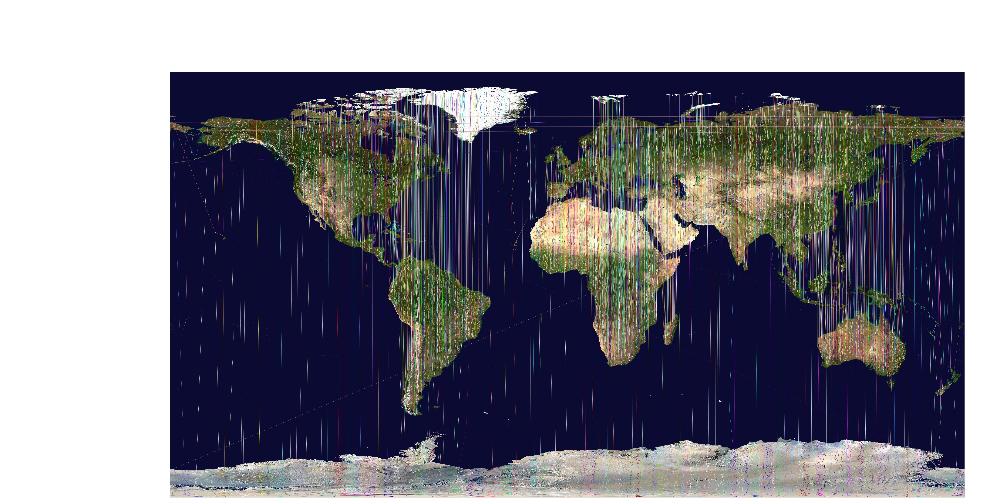

In [29]:
c = colors.cnames.keys()

fig = plt.figure(frameon=False)
fig.set_size_inches(120,60)

ax = plt.Axes(fig, [0., 0., 1., 1.])
ax.set_axis_off()
fig.add_axes(ax)

ax.imshow(earth, aspect='normal')

n_trips = gifts_df['TripId'].max()
for i in range(1, n_trips+1):
    trip = gifts_df[gifts_df['TripId'] == i]
    
    x = trip['Longitude'].values
    y = trip['Latitude'].values
    
    x_, y_ = transform(x,y)
    ax.plot(x_,y_,c=random.choice(c))
        
fig.savefig('trips2.png')